In [1]:
!nvidia-smi


Sun Jul  9 15:14:02 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 525.85.12    Driver Version: 525.85.12    CUDA Version: 12.0     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   63C    P8    11W /  70W |      0MiB / 15360MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/content


In [3]:
!pip install ultralytics==8.0.20

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 261.2/261.2 kB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.7/211.7 kB 23.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 70.2 MB/s eta 0:00:00


In [4]:
from IPython import display
display.clear_output()
!yolo mode=checks

WARNING ⚠️ 'yolo mode=checks' is deprecated. Use 'yolo checks' instead.
Ultralytics YOLOv8.0.20 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 24.2/78.2 GB disk)


In [5]:
from ultralytics import YOLO
from IPython.display import display, Image

In [6]:
%cd {HOME}
!pip install roboflow --quiet
from roboflow import Roboflow
rf = Roboflow(api_key="XOPYgZChJDw791iuAOw0")
project = rf.workspace("objectidentificationprojects").project("plastic_detector")
dataset = project.version(2).download("yolov8")

/content
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 57.0/57.0 kB 3.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 155.3/155.3 kB 10.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 kB 6.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 kB 8.0 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.6/55.6 kB 6.5 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 kB 5.9 MB/s eta 0:00:00
loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to Plastic_Detector-2 in yolov8:: 100%|██████████| 462/462 [00:02<00:00, 174.34it/s]


In [7]:
%cd {HOME}
!yolo task=detect mode=train model=yolov8s.pt data={dataset.location}/data.yaml epochs=15

/content
100% 21.5M/21.5M [00:00<00:00, 216MB/s]

Ultralytics YOLOv8.0.20 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
yolo/engine/trainer: task=detect, mode=train, model=yolov8s.yaml, data=/content/Plastic_Detector-2/data.yaml, epochs=15, patience=50, batch=16, imgsz=640, save=True, cache=False, device=, workers=8, project=None, name=None, exist_ok=False, pretrained=False, optimizer=SGD, verbose=True, seed=0, deterministic=True, single_cls=False, image_weights=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, overlap_mask=True, mask_ratio=4, dropout=False, val=True, save_json=False, save_hybrid=False, conf=0.001, iou=0.7, max_det=300, half=False, dnn=False, plots=False, source=ultralytics/assets/, show=False, save_txt=False, save_conf=False, save_crop=False, hide_labels=False, hide_conf=False, vid_stride=1, line_thickness=3, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, boxes=True, format=torchscript, keras=False,

In [8]:
!ls {HOME}/runs/detect/train/

args.yaml					    R_curve.png
confusion_matrix.png				    results.csv
events.out.tfevents.1688916207.9d5b58ebd276.2857.0  val_batch0_labels.jpg
F1_curve.png					    val_batch0_pred.jpg
P_curve.png					    weights
PR_curve.png


/content


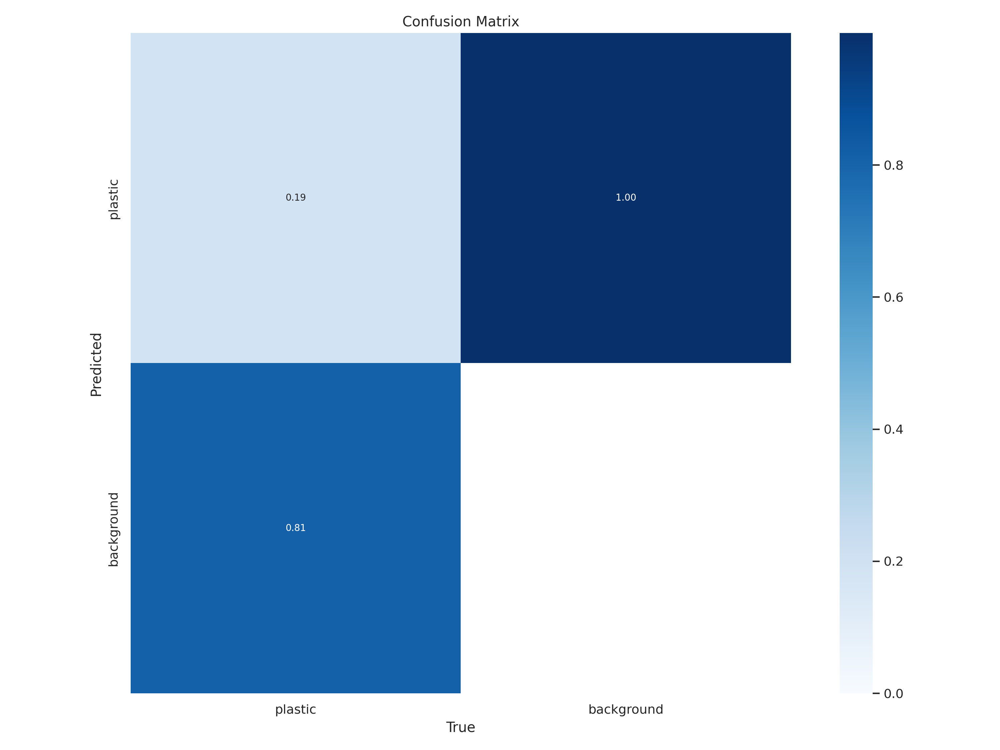

In [9]:
%cd {HOME}
Image(filename=f'{HOME}/runs/detect/train/confusion_matrix.png',width =600)

[Errno 2] No such file or directory: '{Home}'
/content


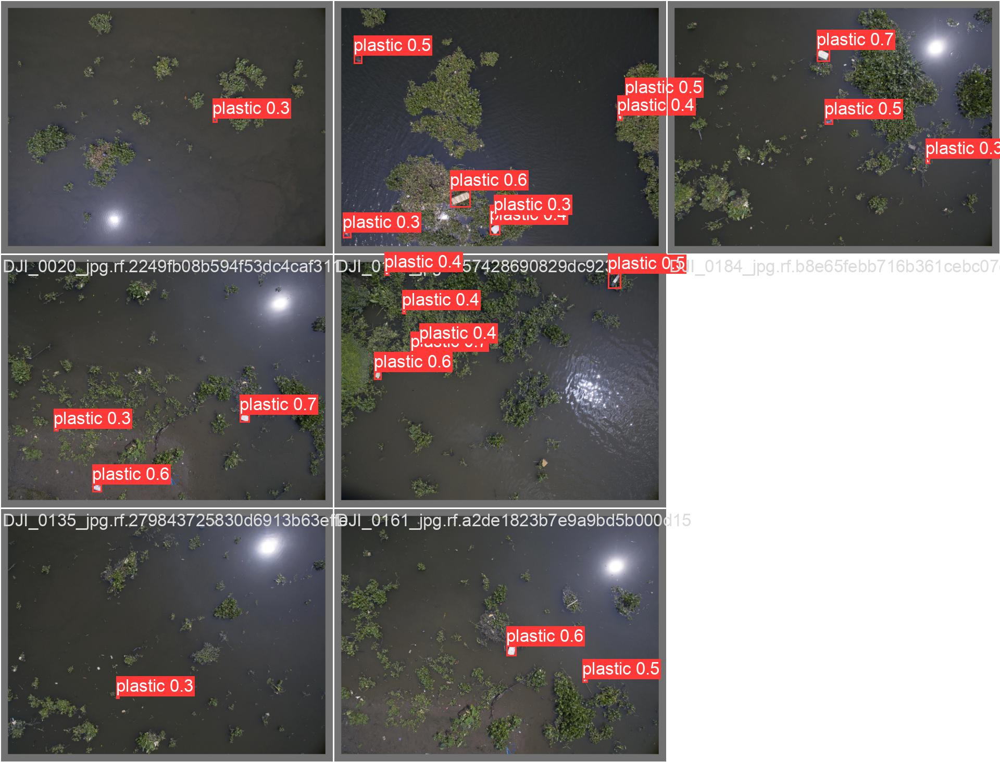

In [10]:
%cd {Home}
Image(filename=f'{HOME}/runs/detect/train/val_batch0_pred.jpg',width =600)

In [11]:
%cd {HOME}
!yolo task=detect mode=val model=/content/runs/detect/train/weights/best.pt data={dataset.location}/data.yaml

/content
2023-07-09 15:49:14.467683: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-09 15:49:15.292712: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.20 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs
val: Scanning /content/Plastic_Detector-2/valid/labels.cache... 7 images, 0 backgrounds, 0 corrupt: 100% 7/7 [00:00<?, ?it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% 1/1 [00:02<00:00,  2.25s/it]
                   all          7        111      0.557      0.351      0.412      0.174
Speed: 0.2ms pre-process, 15.0ms inference, 0.0m

In [28]:
%cd {HOME}
!yolo task=detect mode=predict model=/content/runs/detect/train/weights/best.pt conf=0.1 source=/content/Plastic_Detector-2/predict save=True

/content
2023-07-09 16:49:33.959255: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-07-09 16:49:35.009493: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
Ultralytics YOLOv8.0.20 🚀 Python-3.10.12 torch-2.0.1+cu118 CUDA:0 (Tesla T4, 15102MiB)
Model summary (fused): 168 layers, 11125971 parameters, 0 gradients, 28.4 GFLOPs
image 1/10 /content/Plastic_Detector-2/predict/WhatsApp Im9.39.01.jpg: 480x640 10 plastics, 58.7ms
image 2/10 /content/Plastic_Detector-2/predict/WhatsApp Image 2023-07-05 at 19.38.55.jpg: 480x640 8 plastics, 13.0ms
image 3/10 /content/Plastic_Detector-2/predict/WhatsApp Image 2023-07-05 at 19.38.56.jpg: 480x640 7 plastics, 13.0ms
image 4/10 /content/Plastic_Detector-2/predict/WhatsAp

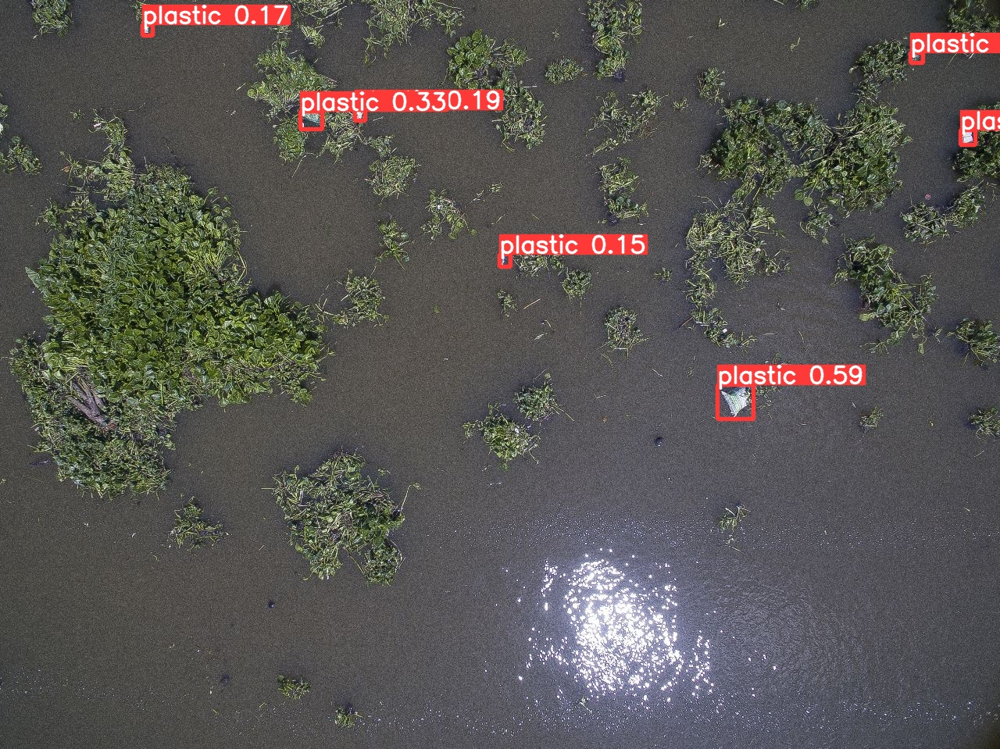

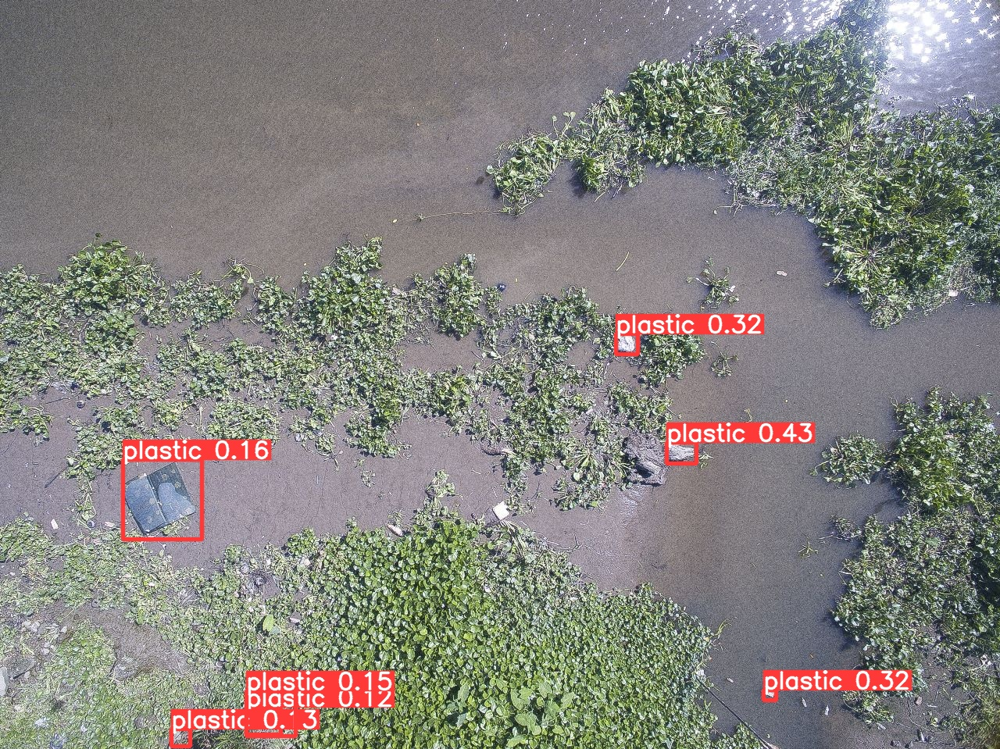

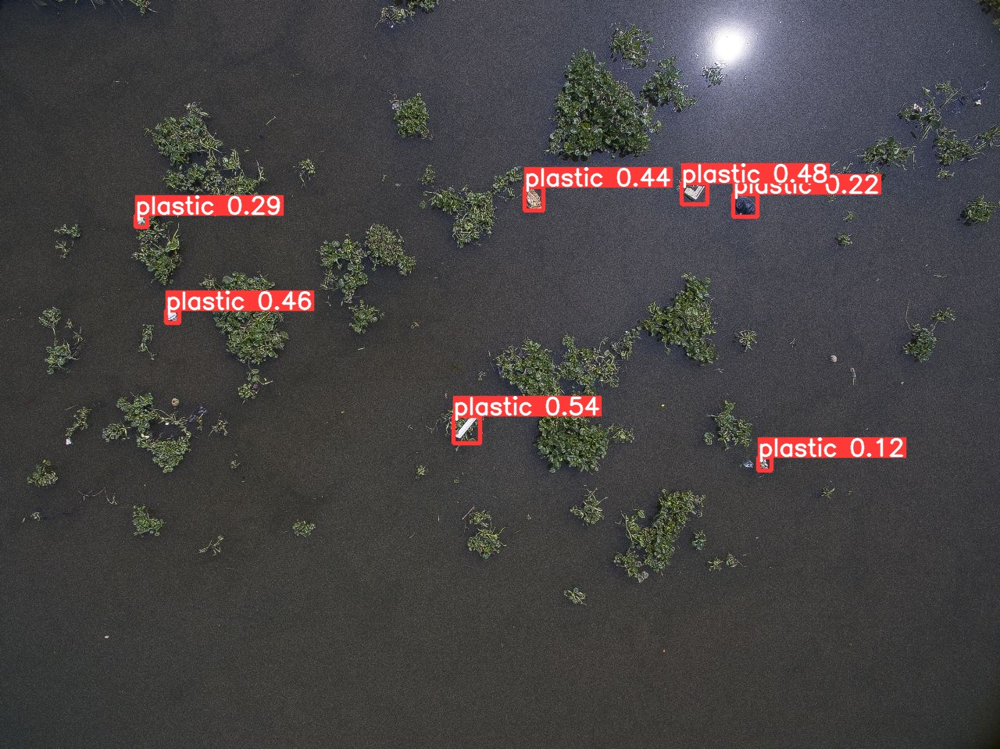

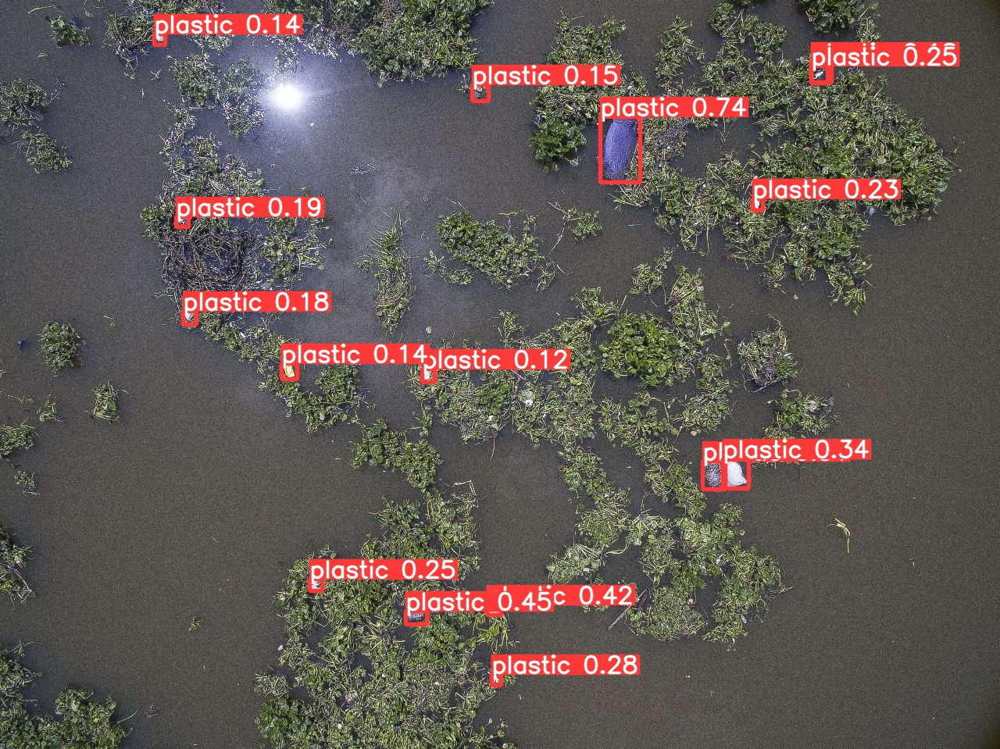

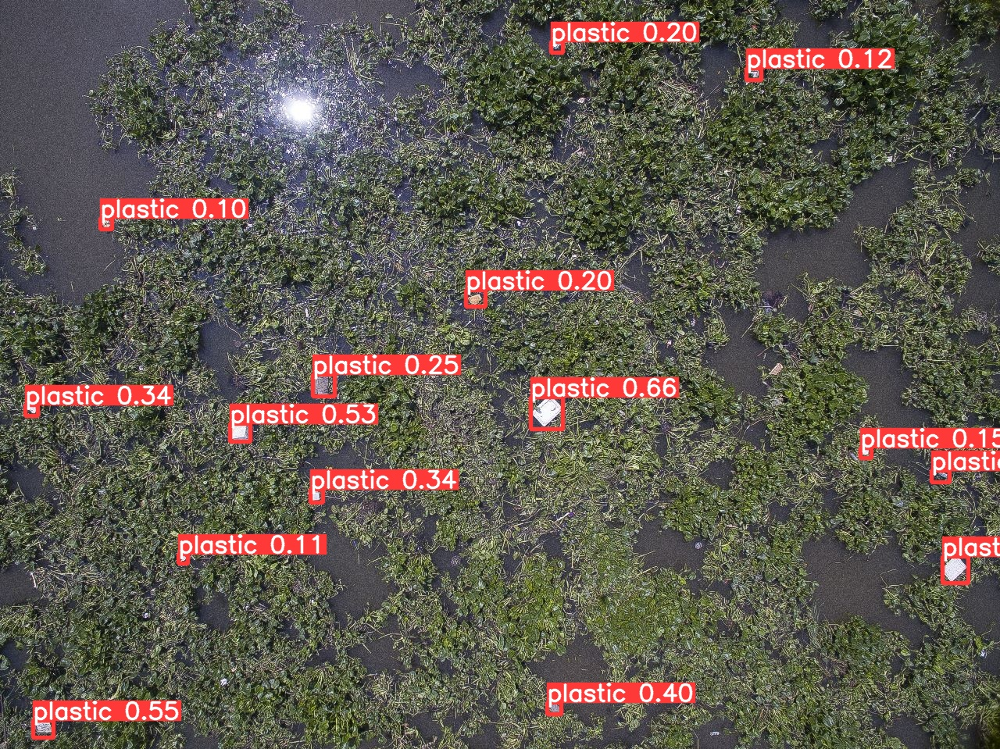

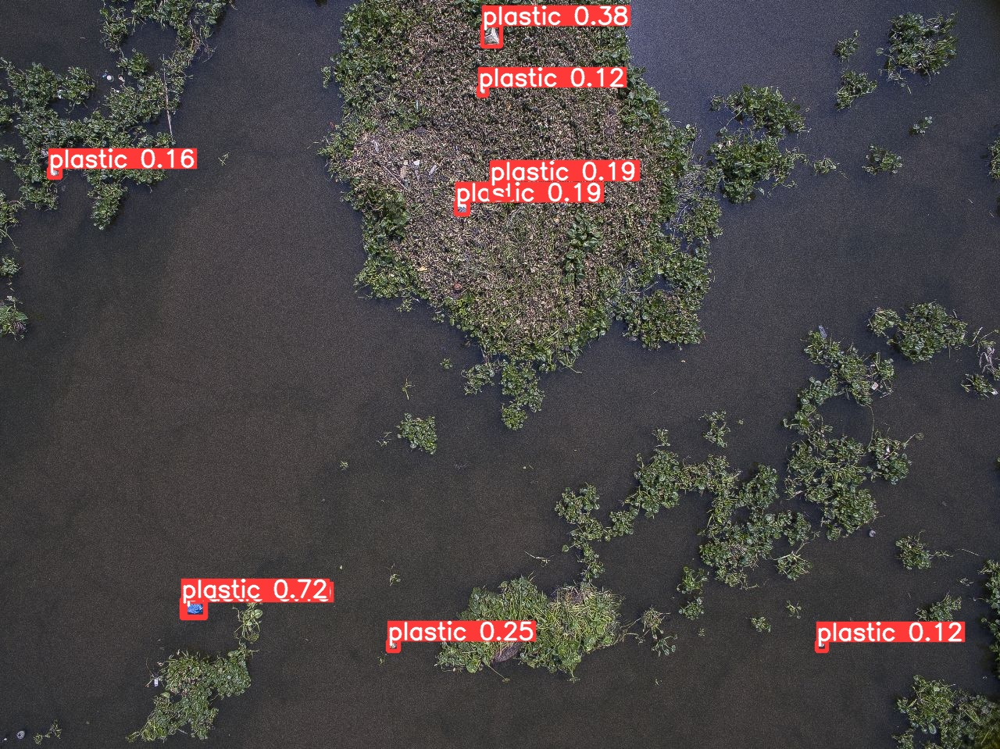

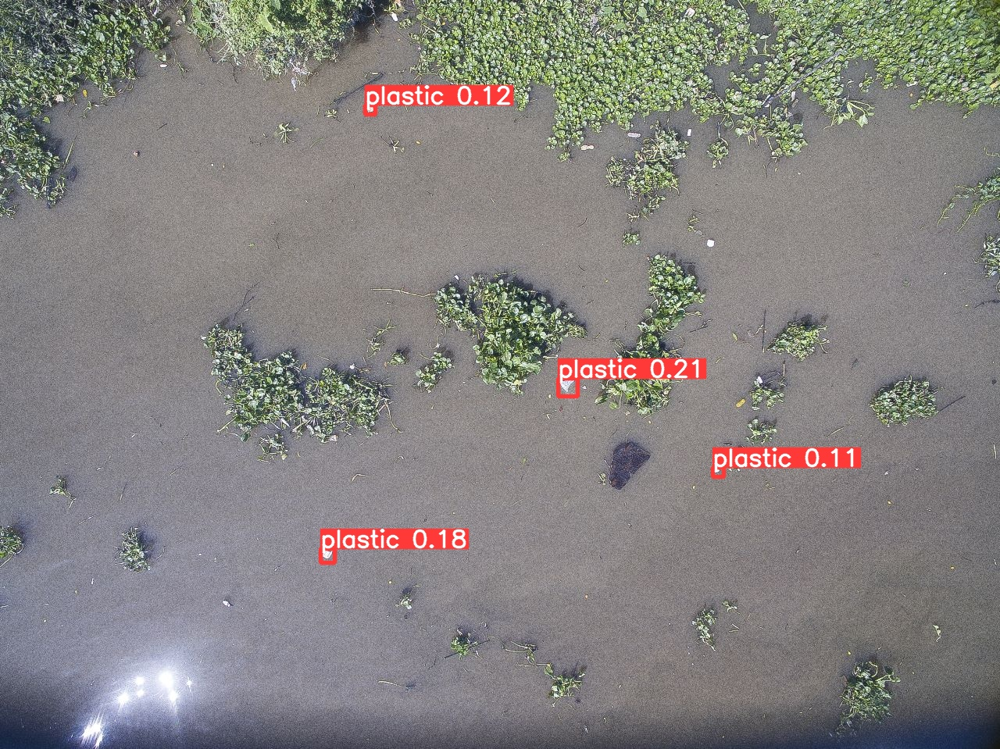

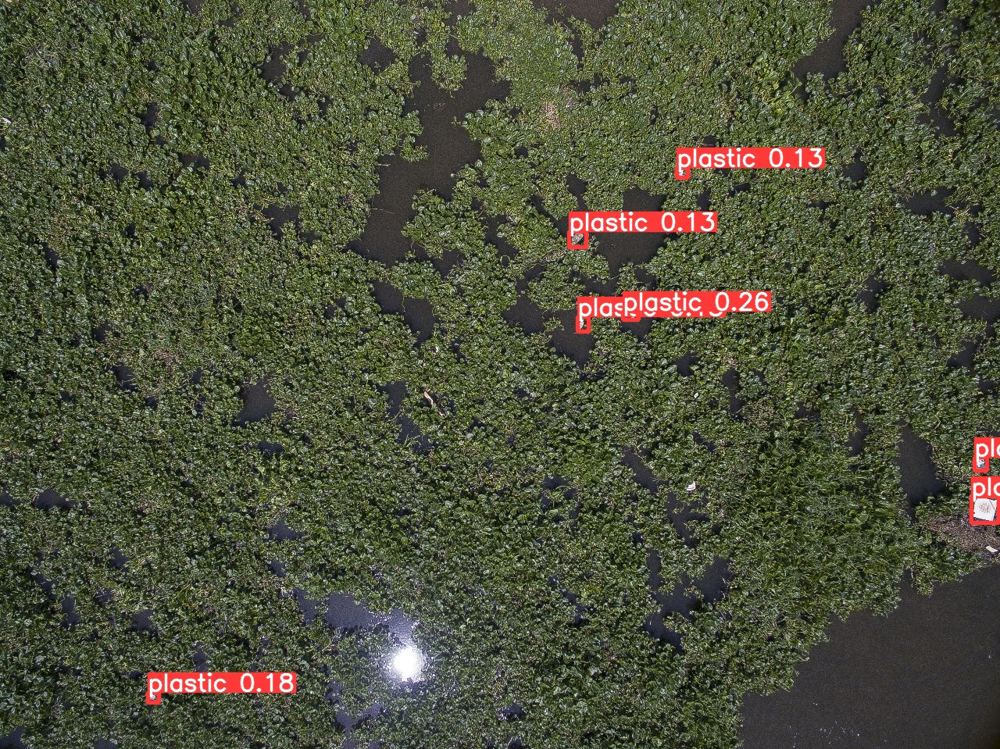

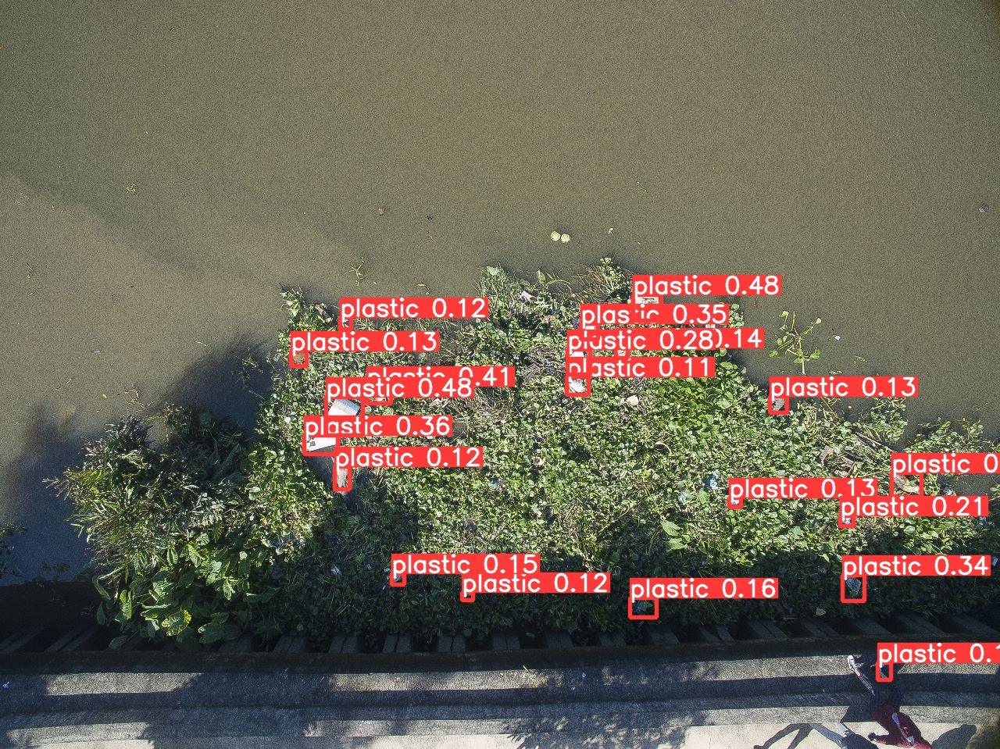

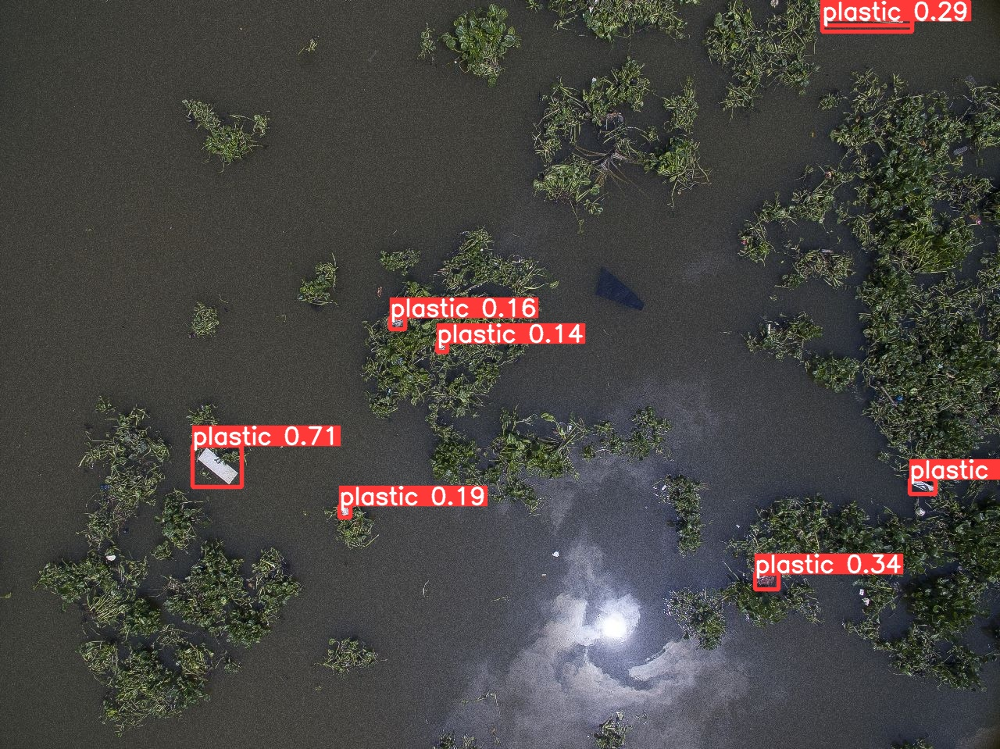

In [29]:
import glob
from IPython.display import Image, display
for image in glob.glob(f'{HOME}/runs/detect/predict3/*.jpg')[:11]:
    display(Image(filename=image, width=600))
    print("\n")

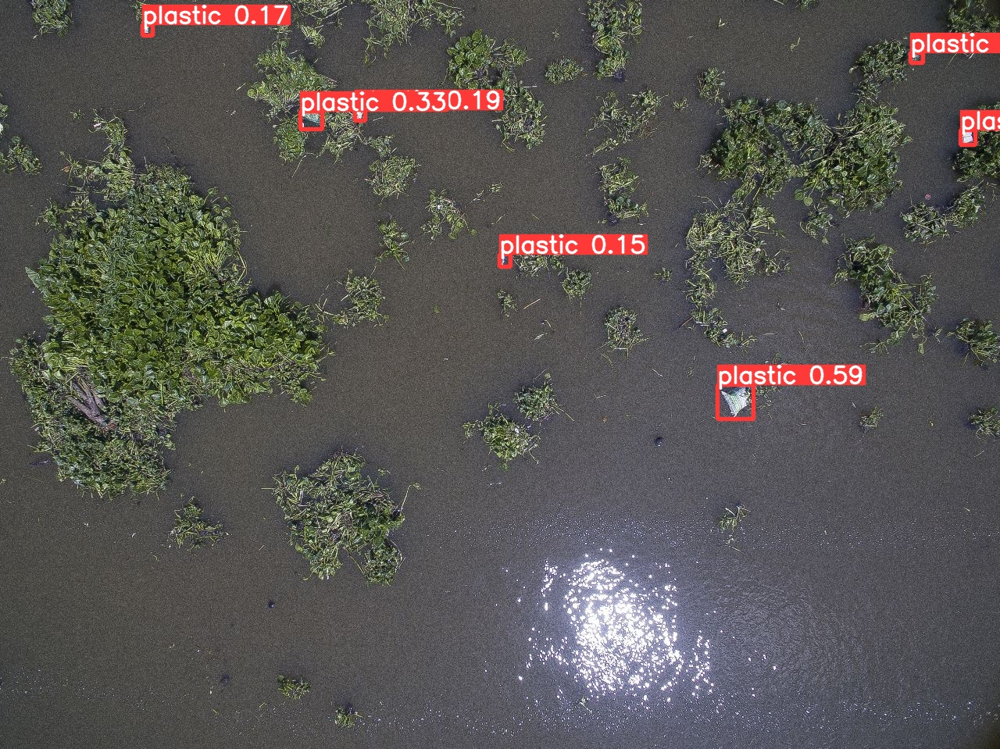

{'predictions': [{'x': 317.5, 'y': 15.5, 'width': 101.0, 'height': 29.0, 'confidence': 0.39282408356666565, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.58.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 628.5, 'y': 128.5, 'width': 43.0, 'height': 29.0, 'confidence': 0.3029991388320923, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.58.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 809.5, 'y': 314.0, 'width': 45.0, 'height': 28.0, 'confidence': 0.28500744700431824, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.58.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 403.5, 'y': 144.5, 'width': 55.0, 'height': 59.0, 'confidence': 0.22734403610229492, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.58.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 12

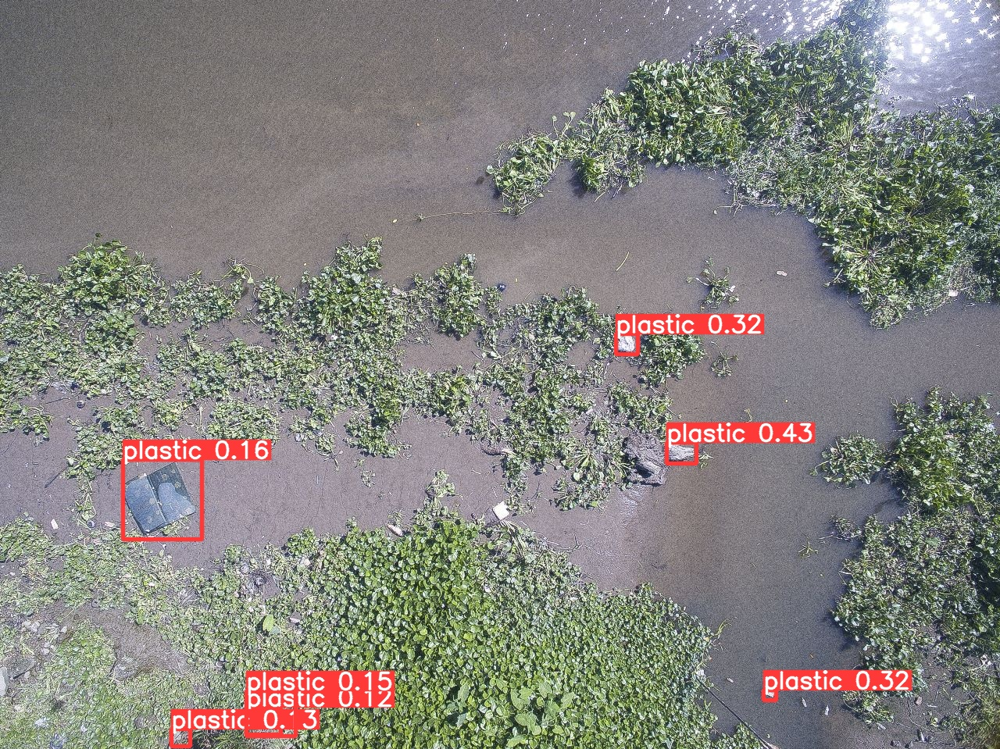

{'predictions': [{'x': 1137.5, 'y': 871.0, 'width': 65.0, 'height': 32.0, 'confidence': 0.3364236652851105, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.59.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 1022.0, 'y': 555.0, 'width': 52.0, 'height': 32.0, 'confidence': 0.25371015071868896, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.59.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 327.5, 'y': 576.5, 'width': 45.0, 'height': 33.0, 'confidence': 0.21918916702270508, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.59.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 999.0, 'y': 880.0, 'width': 54.0, 'height': 46.0, 'confidence': 0.15715336799621582, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.59.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 

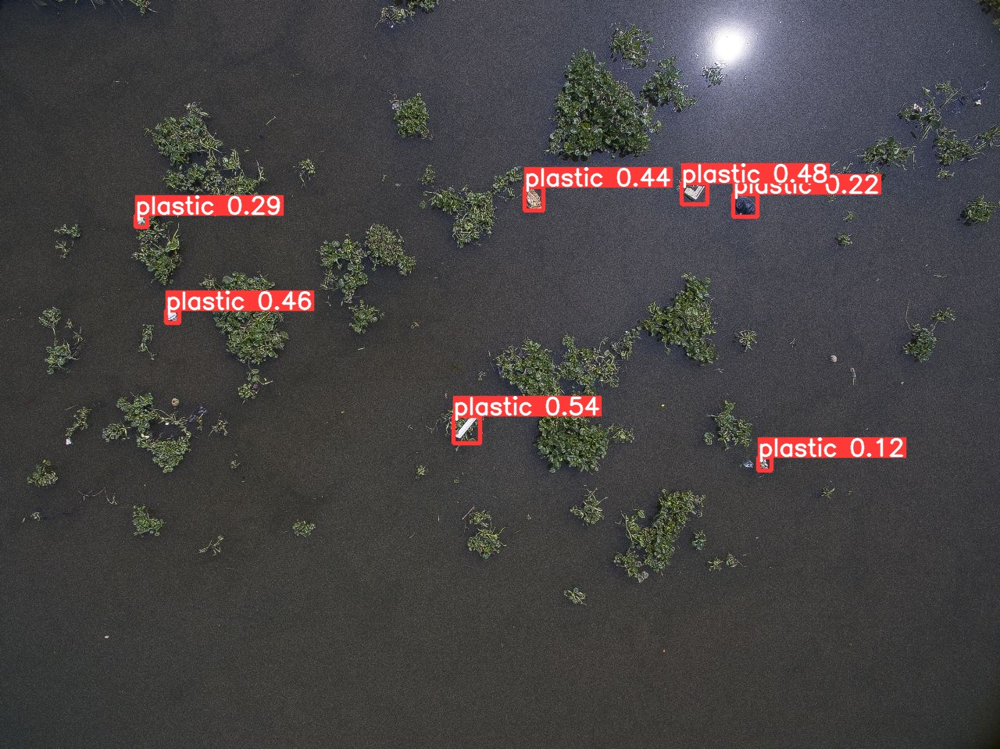

{'predictions': [{'x': 1139.0, 'y': 573.0, 'width': 50.0, 'height': 30.0, 'confidence': 0.37034302949905396, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.00.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 1104.0, 'y': 236.5, 'width': 56.0, 'height': 31.0, 'confidence': 0.34084540605545044, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.00.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 1068.0, 'y': 570.0, 'width': 44.0, 'height': 22.0, 'confidence': 0.3329991102218628, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.00.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 838.5, 'y': 228.0, 'width': 49.0, 'height': 30.0, 'confidence': 0.294097363948822, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.00.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 3

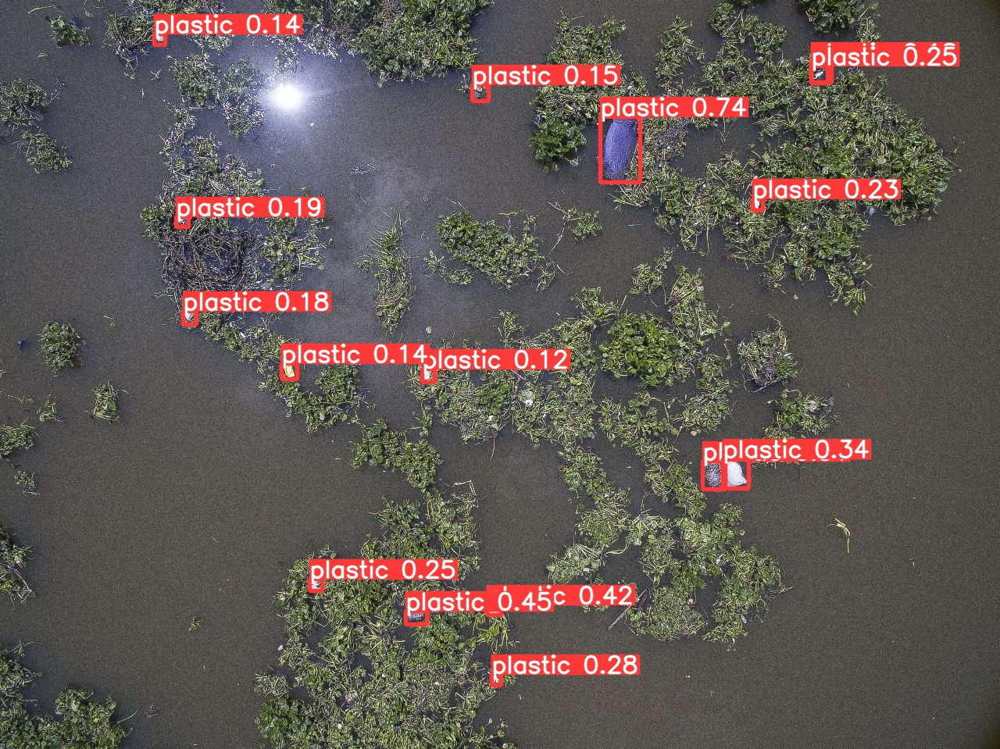

{'predictions': [{'x': 411.5, 'y': 387.5, 'width': 35.0, 'height': 29.0, 'confidence': 0.37533748149871826, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.01.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 398.0, 'y': 266.0, 'width': 40.0, 'height': 28.0, 'confidence': 0.33461993932724, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.01.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 563.5, 'y': 728.5, 'width': 51.0, 'height': 29.0, 'confidence': 0.323572039604187, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.01.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 367.5, 'y': 31.5, 'width': 47.0, 'height': 29.0, 'confidence': 0.2700997292995453, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.01.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 769.0, '

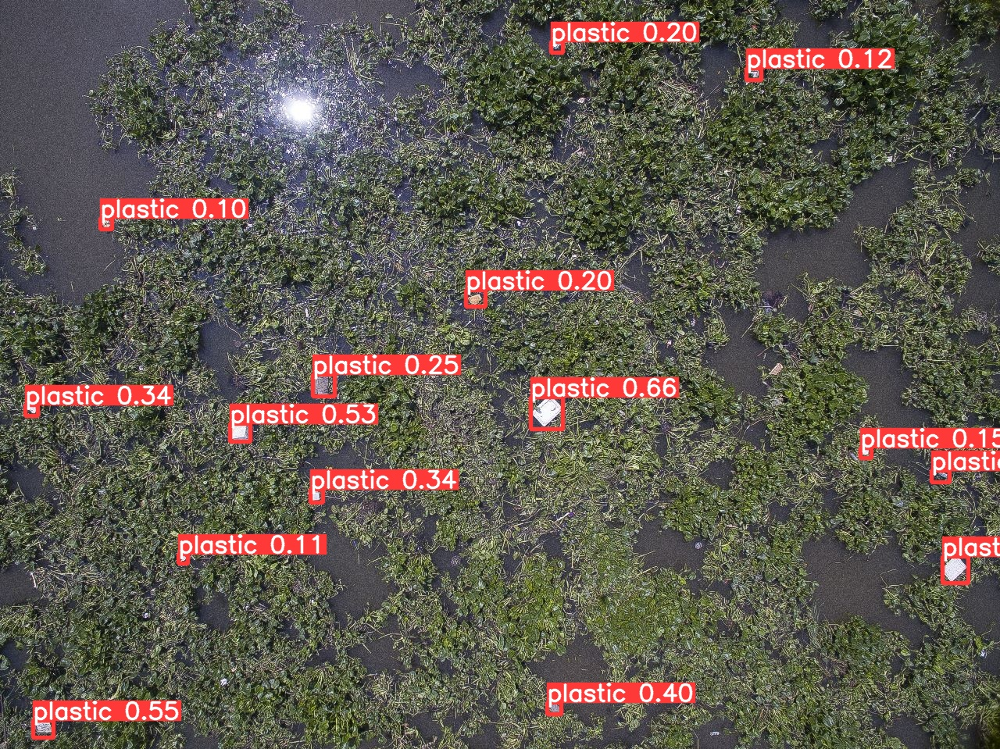

{'predictions': [{'x': 757.5, 'y': 359.0, 'width': 57.0, 'height': 32.0, 'confidence': 0.32710644602775574, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.03.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 302.0, 'y': 267.0, 'width': 38.0, 'height': 28.0, 'confidence': 0.24988380074501038, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.03.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 868.0, 'y': 886.5, 'width': 50.0, 'height': 31.0, 'confidence': 0.23832985758781433, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.03.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 1117.0, 'y': 75.0, 'width': 62.0, 'height': 30.0, 'confidence': 0.19653424620628357, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.03.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 1

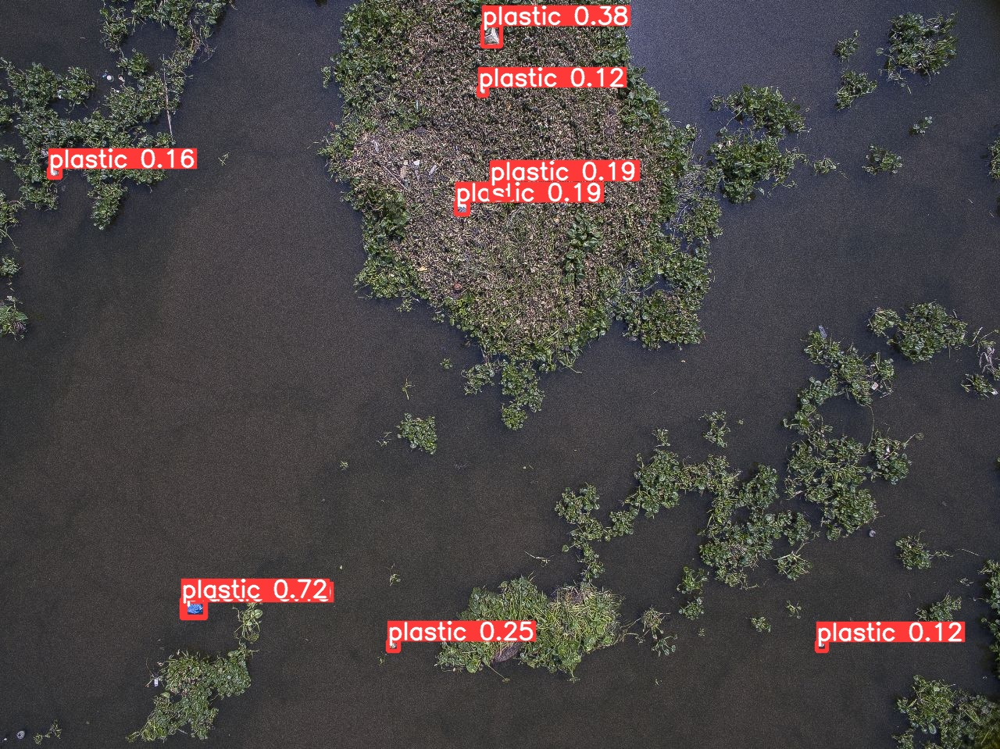

{'predictions': [{'x': 235.5, 'y': 203.5, 'width': 41.0, 'height': 31.0, 'confidence': 0.44427490234375, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Im9.39.01.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 732.0, 'y': 16.0, 'width': 86.0, 'height': 26.0, 'confidence': 0.3483702540397644, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Im9.39.01.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 102.0, 'y': 204.0, 'width': 52.0, 'height': 32.0, 'confidence': 0.3069334626197815, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Im9.39.01.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 70.5, 'y': 211.0, 'width': 31.0, 'height': 46.0, 'confidence': 0.24247220158576965, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Im9.39.01.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 140.0, 'y': 98.5, 'width': 22.0, 'height': 15.0, 'confidence': 0.21060311794281006, 

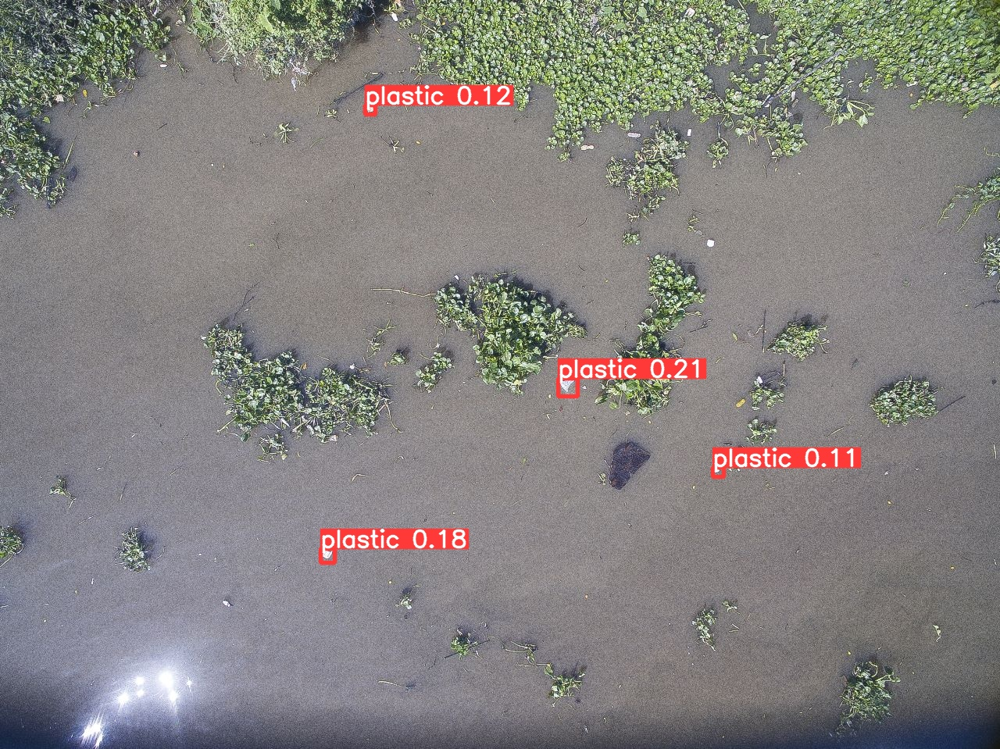

{'predictions': [{'x': 812.0, 'y': 173.0, 'width': 16.0, 'height': 10.0, 'confidence': 0.2557674050331116, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.02.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 630.0, 'y': 121.5, 'width': 62.0, 'height': 33.0, 'confidence': 0.246517151594162, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.02.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 751.5, 'y': 188.5, 'width': 19.0, 'height': 13.0, 'confidence': 0.18403995037078857, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.02.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 77.5, 'y': 127.0, 'width': 15.0, 'height': 12.0, 'confidence': 0.18205586075782776, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.39.02.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 884.0

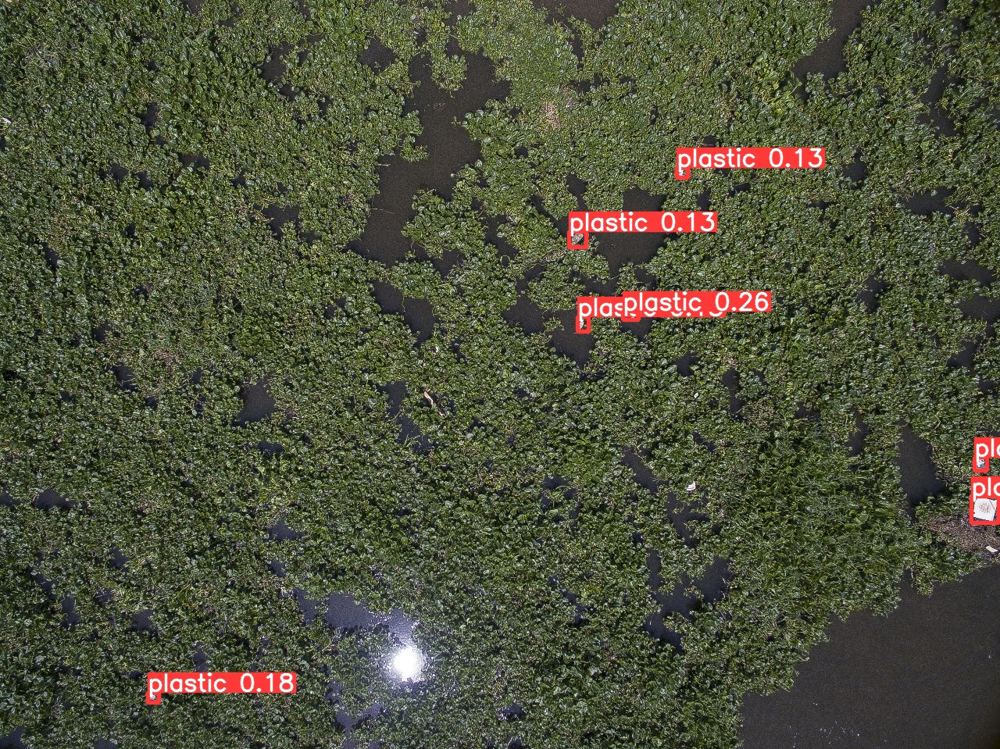

{'predictions': [{'x': 353.5, 'y': 874.0, 'width': 59.0, 'height': 32.0, 'confidence': 0.2984459400177002, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.56.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 1260.0, 'y': 586.5, 'width': 38.0, 'height': 59.0, 'confidence': 0.18719613552093506, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.56.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 964.0, 'y': 385.5, 'width': 56.0, 'height': 33.0, 'confidence': 0.1849648654460907, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.56.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 860.5, 'y': 283.5, 'width': 73.0, 'height': 25.0, 'confidence': 0.1765637993812561, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.56.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 53.

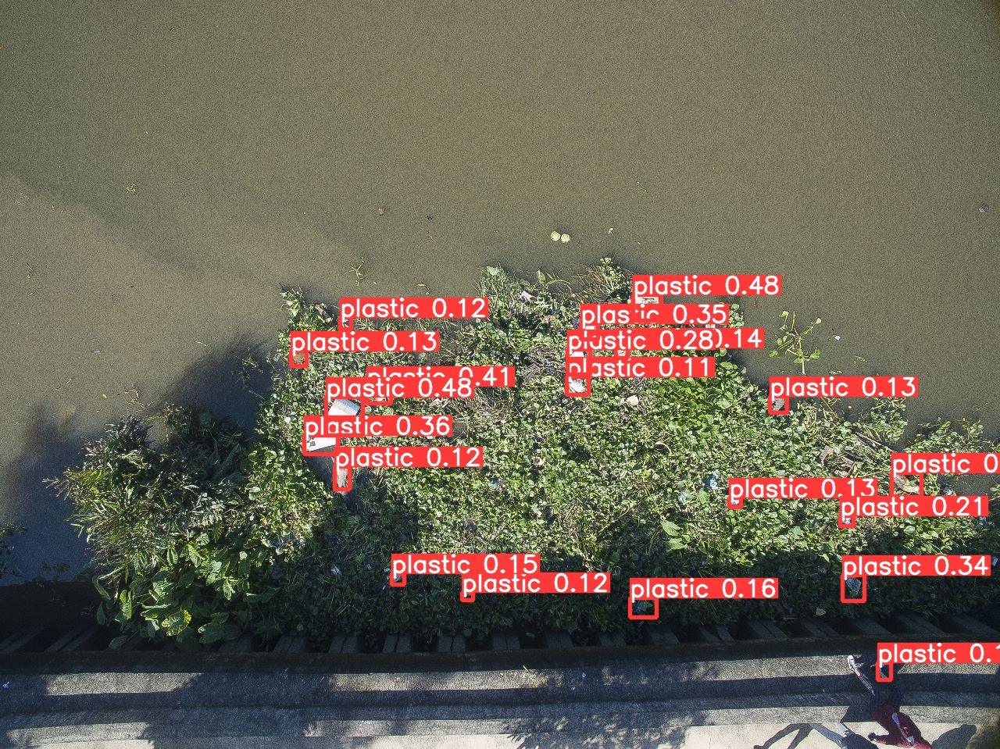

{'predictions': [{'x': 763.5, 'y': 745.5, 'width': 43.0, 'height': 27.0, 'confidence': 0.4585127830505371, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.57.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 980.5, 'y': 753.5, 'width': 41.0, 'height': 29.0, 'confidence': 0.2748416066169739, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.57.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 638.5, 'y': 482.5, 'width': 45.0, 'height': 29.0, 'confidence': 0.17931371927261353, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.57.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 1248.0, 'y': 648.0, 'width': 40.0, 'height': 28.0, 'confidence': 0.15772795677185059, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.57.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 8.

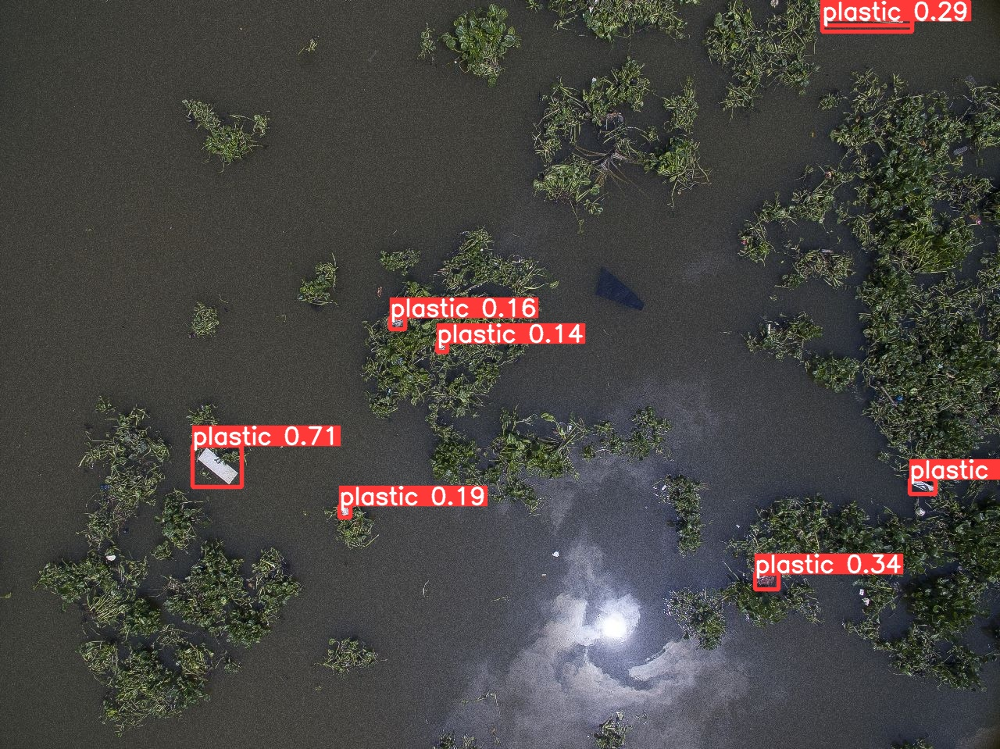

{'predictions': [{'x': 1252.0, 'y': 602.0, 'width': 56.0, 'height': 36.0, 'confidence': 0.4713577330112457, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.55.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 1132.5, 'y': 722.0, 'width': 59.0, 'height': 32.0, 'confidence': 0.3296175003051758, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.55.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 730.0, 'y': 428.0, 'width': 46.0, 'height': 30.0, 'confidence': 0.28950273990631104, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.55.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 1211.5, 'y': 14.0, 'width': 67.0, 'height': 26.0, 'confidence': 0.1868884265422821, 'class': 'plastic', 'image_path': '/content/runs/detect/predict3/WhatsApp Image 2023-07-05 at 19.38.55.jpg', 'prediction_type': 'ObjectDetectionModel'}, {'x': 10

In [32]:
import glob
from IPython.display import Image, display
model = project.version(2).model
for image in glob.glob(f'{HOME}/runs/detect/predict3/*.jpg'):
    display(Image(filename=image, width=600))
    results=model.predict(image, confidence=10, overlap=30)
    print(model.predict(image, confidence=10, overlap=30).json())
    print(len(results))\
